In [1]:
import nibabel as nib
import numpy as np
import re,subprocess
import matplotlib.pyplot as plt
aa=np.asarray
from utils import *
from tqdm import tqdm


In [2]:
als_nii_file="../D99_v2.0_dist/D99_atlas_v2.0.nii.gz"
als_epi_img = nib.load(als_nii_file)
als_epi_img_data = als_epi_img.get_fdata()

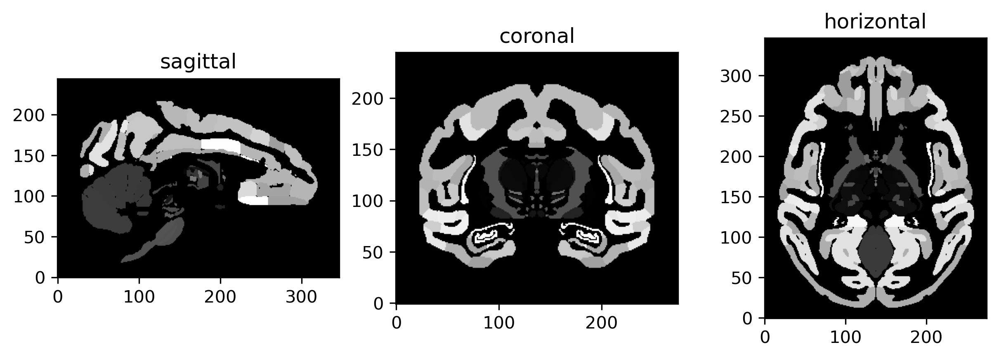

In [3]:
show_slices(als_epi_img_data)

In [4]:
als_epi_img = nib.load("../D99_v2.0_dist/D99_atlas_v2.0.nii.gz")
als_epi_img_data = als_epi_img.get_fdata()


def MaskTheArea(area_no):
    """derive the mask area of the specific area in atlas

    Parameters
    ----------
    area_no : int
        area number
    atlas_nii_file : str, optional
        area string name, by default "../D99_v2.0_dist/D99_atlas_v2.0.nii.gz"

    Returns
    -------
    ndarray[float,3]
        mask image
    """
    mask_epi_img_data=np.zeros_like(als_epi_img_data)
    mask_epi_img_data[als_epi_img_data==area_no]=1.
    mask_epi_img=nib.Nifti1Image(mask_epi_img_data, als_epi_img.affine, als_epi_img.header)
    return mask_epi_img


In [5]:
import pandas as pd

table=pd.read_excel("./D99_v2.0_dist/D99_Suppl_Table_1.xlsx",
    sheet_name=1,keep_default_na=False, na_values='')
table.set_index('Atlas_label',inplace=True)

# Area generation

In [7]:
# generate specific area mask
for idx,abr in tqdm(table['Abbreviation'].items()):
    mask=MaskTheArea(idx)
    abr=abr.replace('/','_')
    nib.save(mask,f"./D99_mask/{idx}_{abr}.nii.gz")

368it [01:36,  3.81it/s]


# Figure gereration for each area

In [9]:
import glob,warnings
from pathlib import Path

20it [00:10,  2.13it/s]/var/folders/8s/knjvr7cx7z756f0nxcjfc29h0000gn/T/ipykernel_66632/3925991221.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,axes=plt.subplots(1,3,figsize=(10,3),dpi=300)
32it [00:15,  2.27it/s]/var/folders/8s/knjvr7cx7z756f0nxcjfc29h0000gn/T/ipykernel_66632/3925991221.py:11: UserWarning: Area v23a does not exist.
  warnings.warn("Area %s does not exist."%brain_area_name)
289it [02:10,  2.25it/s]/var/folders/8s/knjvr7cx7z756f0nxcjfc29h0000gn/T/ipykernel_66632/3925991221.py:11: UserWarning: Area H2 does not exist.
  warnings.warn("Area %s does not exist."%brain_area_name)
294it [02:12,  2.33it/s]/var/folders/8s/knjvr7cx7z756f0nxcjfc29h0000gn/T/ipykernel_66632/3925991221.py:11: UserWarning: Area Re does not exist.
  warnings.warn("Area 

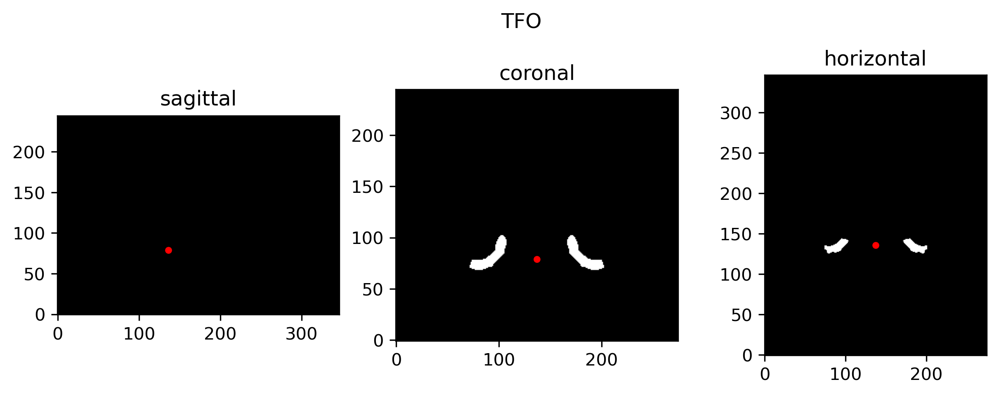

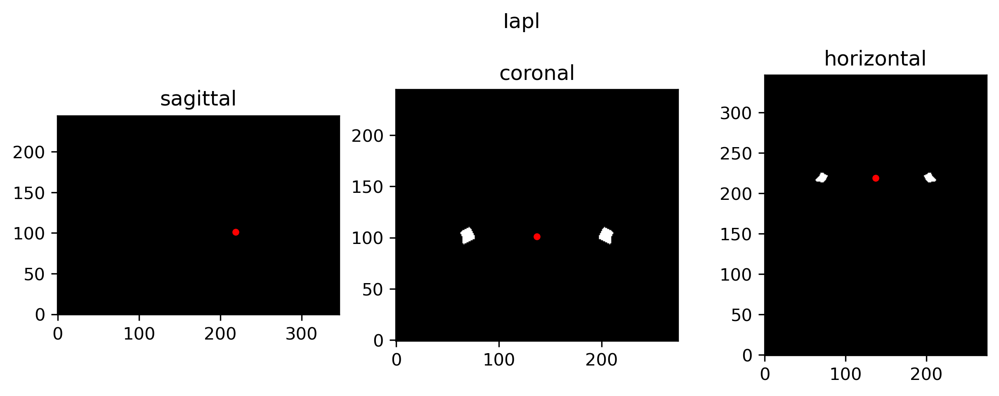

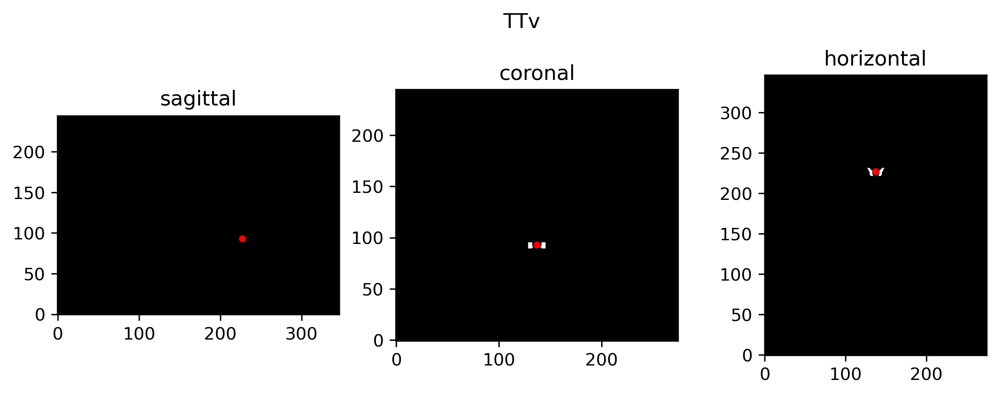

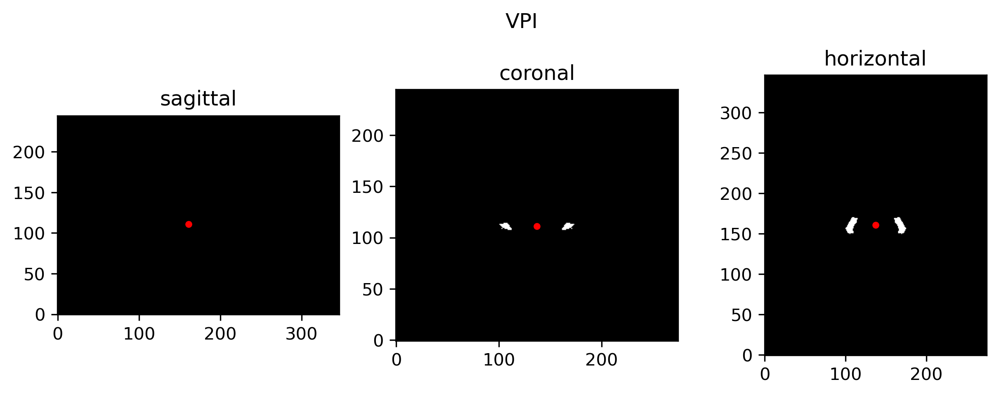

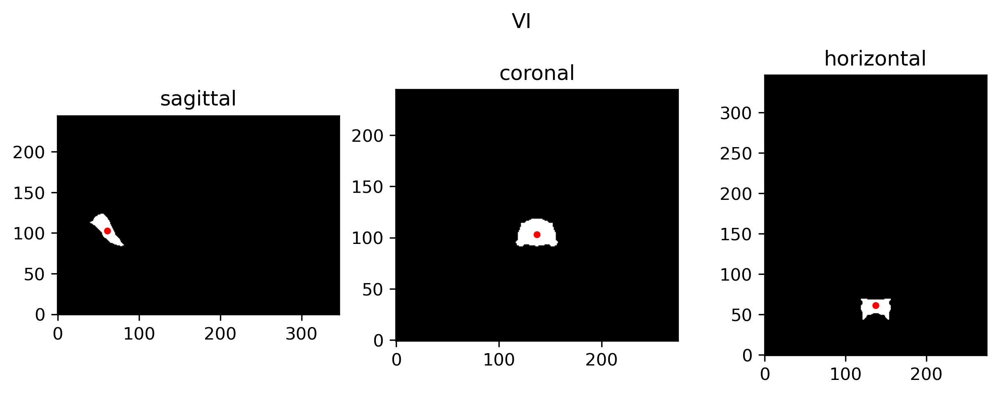

...

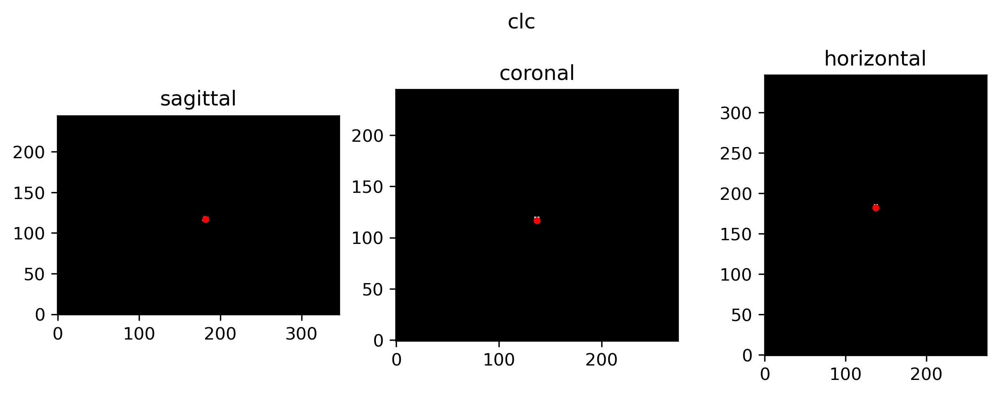

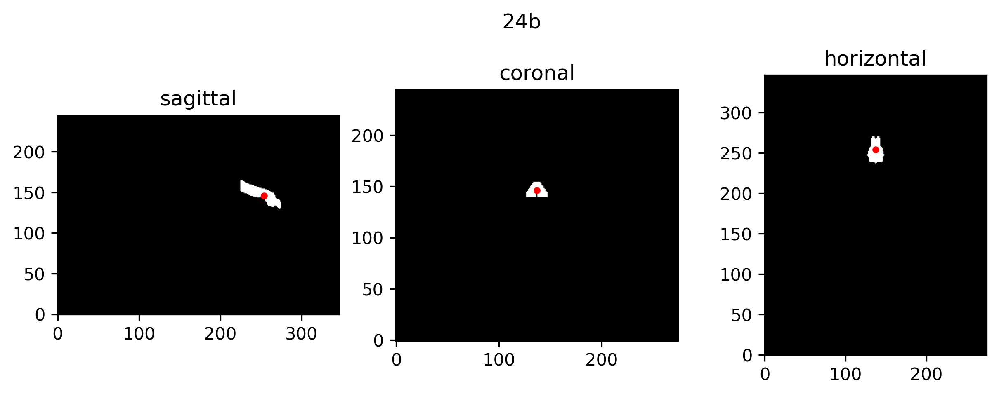

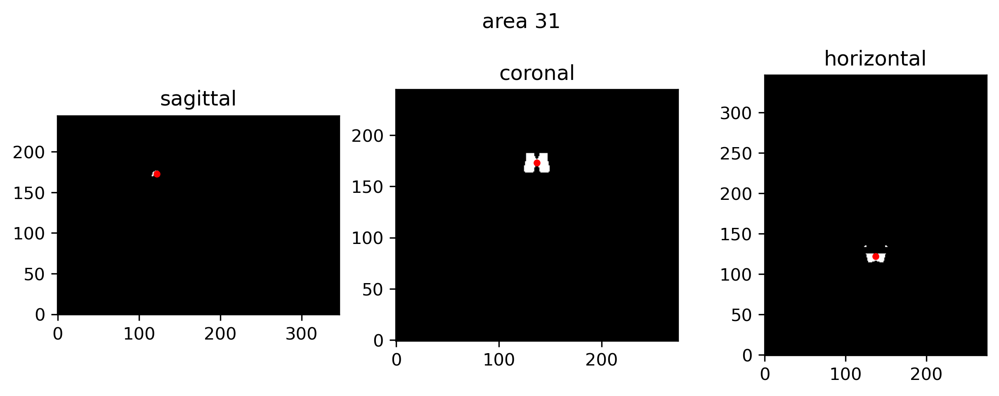

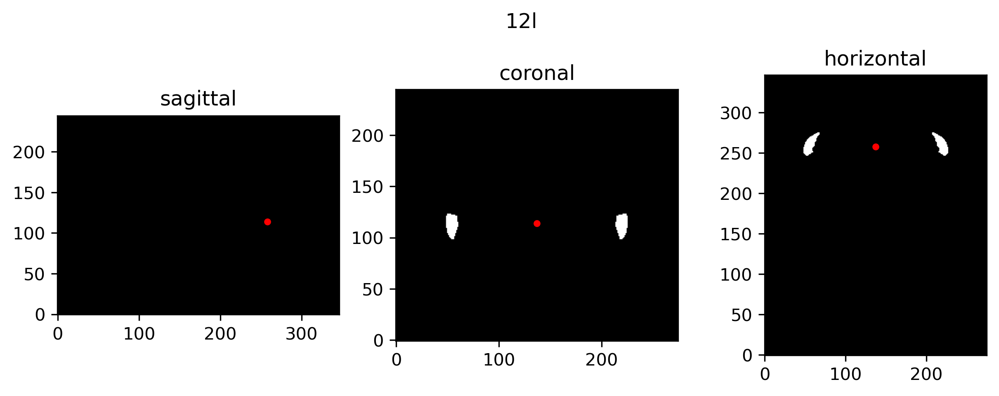

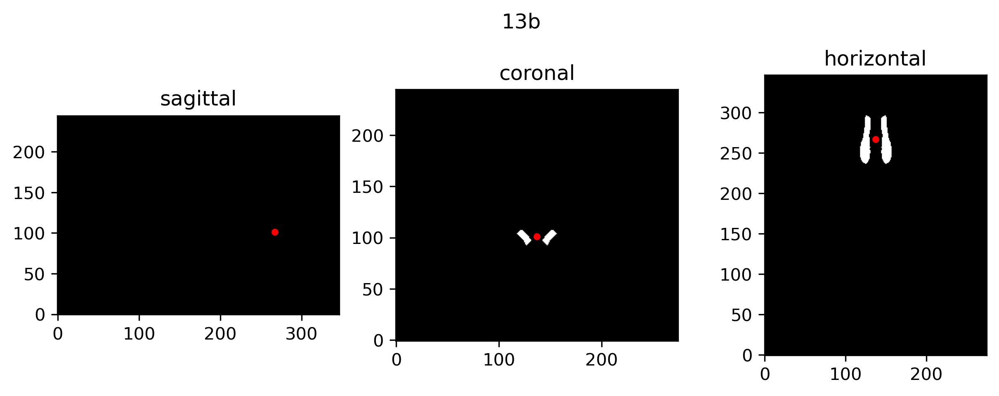

In [10]:
mask_folder="./D99_mask/"
mask_folder_paths=f"{mask_folder}*.nii.gz"
mask_paths=glob.glob(mask_folder_paths)
for i,mask_path in tqdm(enumerate(mask_paths)):
    basename=Path(mask_path).stem[:-4]
    brain_area_name='_'.join(basename.split('_')[1:])
    mask_epi_img = nib.load(mask_path)
    mask_epi_img_data = mask_epi_img.get_fdata()
    positions=np.where(mask_epi_img_data>0.99)
    if positions[0].size==0:
        warnings.warn("Area %s does not exist."%brain_area_name)
        continue
    med=[int(np.median(positions[i])) for i in range(3)]
    fig,axes=plt.subplots(1,3,figsize=(10,3),dpi=300)
    show_slices(mask_epi_img_data,EBZ=med,title=brain_area_name,fig=fig,axes=axes)
    plt.savefig(f"{mask_folder}{basename}.svg")

